# Twitter Sentiment Analysis: Toronto Tweets
By: Jennifer Johnson

Exploratory Data Analysis on Twitter data filtered for Toronto Only

References:
https://github.com/tthustla/twitter_sentiment_analysis_part2/blob/master/Capstone_part3-Copy1.ipynb

https://github.com/tthustla/twitter_sentiment_analysis_part3/blob/master/Capstone_part3-Copy2.ipynb

In [1]:
import pandas as pd
import re
import spacy
import nltk
import string
import ast
import numpy as np
import seaborn as sns

import missingno as msno

from datetime import datetime
from wordcloud import WordCloud
import matplotlib.pyplot as plt
%matplotlib inline

sns.set(style="whitegrid") 

In [2]:
spacy.load('en')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Error loading wordnet: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>
[nltk_data] Error loading stopwords: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>
[nltk_data] Error loading punkt: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>


False

In [3]:
from spacy.lang.en import English
from nltk.corpus import wordnet as wn
from nltk.stem.wordnet import WordNetLemmatizer
from translate import Translator

parser = English()
translator = Translator(to_lang="English")

In [4]:
def get_lemma(word):
    lemma = wn.morphy(word)
    if lemma is None:
        return word
    else:
        return lemma

In [5]:
# Filter out stopwords
en_stop = set(nltk.corpus.stopwords.words('english'))

In [6]:
def processTweet(tweet):
    # process the tweets
    translator = str.maketrans('', '', string.punctuation)

    #Convert to lower case
    tweet = tweet.lower()
    
    #Convert www.* or https?://* to URL
    tweet = re.sub('((www\.[^\s]+)|(https?://[^\s]+))','',tweet)
    
    #Convert @username to AT_USER
    tweet = re.sub('@[^\s]+','',tweet)
    
    #Remove additional white spaces
    tweet = re.sub('[\s]+', ' ', tweet)
    
    #Replace #word with word
    tweet = re.sub(r'#([^\s]+)', r'\1', tweet)
    
    #trim
    tweet = tweet.strip('\'"')
    
    #remove punctuation from text
    tweet = tweet.translate(translator)
    
    tweet = tweet.split()
    tweet = [get_lemma(token) for token in tweet]
    tweet = [token for token in tweet if token not in en_stop]
    tweet = ' '.join(tweet)
    return tweet

In [7]:
# Load dataframe
tweets_df = pd.read_csv('D:/development/CSDA1050/playground/twitter_jj/twitter_tweets_new.csv')
tweets_df = tweets_df[tweets_df['place_country']=='Canada']
tweets_df.shape

(299111, 24)

In [8]:
# changing tweet_text to String column (returned error about 'float')
# when full dataset was used
tweets_df['tweet_text'] = tweets_df['tweet_text'].astype(str)
tweets_df['tweet_clean'] = tweets_df['tweet_text'].apply(processTweet)

In [9]:
import pytz

In [10]:
def getTZ(tweet_date):
    est = pytz.timezone('US/Eastern')
    
    tweet_date = pd.Timestamp(tweet_date).tz_localize('UTC')
    tweet_date = tweet_date.astimezone(est)
    
    return tweet_date

In [11]:
# changing tweet_date to DateTime column
tweets_df.tweet_date = pd.to_datetime(tweets_df['tweet_date'])
tweets_df['tweet_date'] = tweets_df['tweet_date'].apply(getTZ)

In [12]:
# split sentiment
tweets_df['sentiment'] = tweets_df['sentiment'].apply(lambda x:dict(eval(x)))
tweets_sent = tweets_df['sentiment'].apply(pd.Series)
tweets_df = pd.concat([tweets_df, tweets_sent], axis=1).drop('sentiment', axis=1)
tweets_df['sentiment'] = None
tweets_df.loc[tweets_df['compound'] >= 0.05, 'sentiment'] = 'positive'
tweets_df.loc[(tweets_df['compound'] > -0.05) & (tweets_df['compound'] < 0.05), 'sentiment'] = 'neutral'
tweets_df.loc[tweets_df['compound'] <= -0.05, 'sentiment'] = 'negative'

In [13]:
tweets_df.head()

,emojis,hashtags,id,language,latitude,longitude,mentions,place_bbcoordinates,place_bbtype,place_country,...,tweet_date,tweet_text,user_id,user_name,tweet_clean,neg,neu,pos,compound,sentiment
0,[':red_heart:'],NaN,1107369998148788224,en,NaN,NaN,NaN,"[[[-79.583667, 43.550871], [-79.583667, 43.550...",Polygon,Canada,...,2019-03-17 15:55:56.155000-04:00,Loving the vibes :red_heart:️ https://t.co/X8v...,908049944040361984,wikki_87,love vibes redheart️,0.000,0.506,0.494,0.5994,positive
1,[],NaN,1107370010182324229,und,NaN,NaN,"['Rosalestri', 'Cnyari']","[[[-80.248423, 43.050553], [-80.248423, 43.470...",Polygon,Canada,...,2019-03-17 15:55:59.024000-04:00,@Rosalestri @Cnyari Olé,16801721,njsh2008,olé,0.000,1.000,0.000,0.0000,neutral
4,"[':fearful_face:', ':fearful_face:', ':flushed...",NaN,1107370005883023360,ko,NaN,NaN,['BTS_twt'],"[[[-95.155898, 41.676329], [-95.155898, 56.852...",Polygon,Canada,...,2019-03-17 15:55:57.999000-04:00,"@BTS_twt 김태형, 밴드에이드? :fearful_face::fearful_fa...",828139192035196928,BangtanBabeXO,김태형 밴드에이드 fearfulfacefearfulface wa cut hope d...,0.187,0.510,0.304,0.5330,positive
5,[],NaN,1107370047134224384,en,NaN,NaN,['MazharAbbasGEO'],"[[[-79.810142, 43.373074], [-79.810142, 43.737...",Polygon,Canada,...,2019-03-17 15:56:07.834000-04:00,@MazharAbbasGEO WHAT ABOUT THIS SHAMELESS http...,127687121,ZA_chaudhry,shameless,0.423,0.577,0.000,-0.5670,negative
6,[],"['torontocontractors', 'renovation', 'interior...",1107370085608538113,en,43.7166,-79.3407,NaN,"[[[-79.639319, 43.403221], [-79.639319, 43.855...",Polygon,Canada,...,2019-03-17 15:56:17.007000-04:00,"Before and after, big different....\n.\n.\n.\n...",349291874,905RENO,big different torontocontractors renovation in...,0.000,1.000,0.000,0.0000,neutral


## Word Cloud
Negative Sentiment analysis 

In [14]:
# Wordclouds for Sentiment
neg_tweets = tweets_df[tweets_df.sentiment == 'negative']
neg_string = []
for t in neg_tweets.tweet_clean:
    neg_string.append(t)
neg_string = pd.Series(neg_string).str.cat(sep=' ')

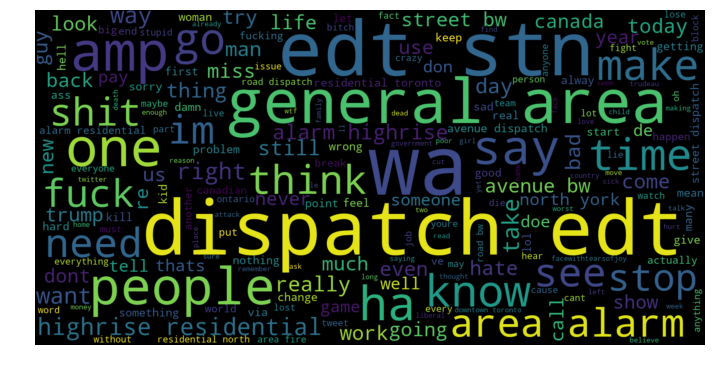

In [15]:
wordcloud = WordCloud(width=1600, height=800,max_font_size=200).generate(neg_string)
plt.figure(figsize=(12,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

## Word Cloud
Positive Sentiment analysis 

In [19]:
# Wordclouds for Sentiment
pos_tweets = tweets_df[tweets_df.sentiment == 'positive']
pos_string = []
for t in pos_tweets.tweet_clean:
    pos_string.append(t)
pos_string = pd.Series(pos_string).str.cat(sep=' ')

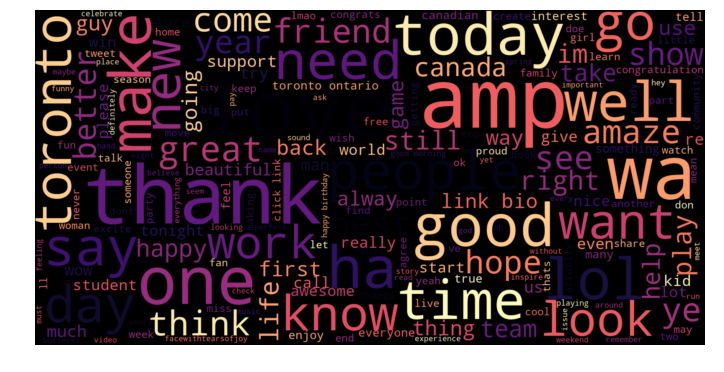

In [20]:
wordcloud = WordCloud(width=1600, height=800,max_font_size=200,colormap='magma').generate(pos_string)
plt.figure(figsize=(12,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

## Term Frequency

In [107]:
df1 = tweets_df[['tweet_clean', 'compound', 'sentiment']]
df1.head()

,tweet_clean,compound,sentiment
0,love vibes redheart️,0.5994,positive
1,olé,0.0000,neutral
4,김태형 밴드에이드 fearfulfacefearfulface wa cut hope d...,0.5330,positive
5,shameless,-0.5670,negative
6,big different torontocontractors renovation in...,0.0000,neutral


In [108]:
# re-sort dataframe by compound sentiment column
df = df1.sort_values(by=['compound'], axis=0, ascending=True).reset_index(drop=True) #,inplace=True)

In [109]:
df.head()

,tweet_clean,compound,sentiment
0,,-0.9990,negative
1,accountable 4 hate violence xenophobia way tou...,-0.9894,negative
2,ban islamic terrorist ban gang ban crack fenta...,-0.9889,negative
3,mood fuck fuck fuck fuck fuck fuck fuck auntie...,-0.9882,negative
4,suck suck suck suck suck suck suck suck thanks...,-0.9852,negative


In [110]:
from sklearn.feature_extraction.text import CountVectorizer
cvec = CountVectorizer()
cvec.fit(df.tweet_clean)

CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=1.0, max_features=None, min_df=1,
        ngram_range=(1, 1), preprocessor=None, stop_words=None,
        strip_accents=None, token_pattern='(?u)\\b\\w\\w+\\b',
        tokenizer=None, vocabulary=None)

In [111]:
len(cvec.get_feature_names())

230942

It looks like the count vectorizer has extracted 230942 words out of the corpus.

In [112]:
neg_doc_matrix = cvec.transform(df[df.sentiment == 'negative'].tweet_clean)
pos_doc_matrix = cvec.transform(df[df.sentiment == 'positive'].tweet_clean)
neu_doc_matrix = cvec.transform(df[df.sentiment == 'neutral'].tweet_clean)
neg_tf = np.sum(neg_doc_matrix,axis=0)
pos_tf = np.sum(pos_doc_matrix,axis=0)
neu_tf = np.sum(neu_doc_matrix,axis=0)
neg = np.squeeze(np.asarray(neg_tf))
pos = np.squeeze(np.asarray(pos_tf))
neu = np.squeeze(np.asarray(neu_tf))
term_freq_df = pd.DataFrame([neg,pos,neu],columns=cvec.get_feature_names()).transpose()

In [113]:
term_freq_df.head()

,0,1,2
00,4,7,16
000,4,23,7
0000,6,1,3
0000001,0,1,0
000003500,0,0,1


In [114]:
term_freq_df.columns = ['negative', 'positive','neutral']
term_freq_df['total'] = term_freq_df['negative'] + term_freq_df['positive'] + term_freq_df['neutral']
term_freq_df.sort_values(by='total', ascending=False).iloc[:10]

,negative,positive,neutral,total
toronto,2883,6964,7828,17675
wa,4929,9130,2784,16843
get,4081,8138,3586,15805
like,2768,12210,409,15387
amp,2637,8046,1964,12647
one,2841,6208,2138,11187
see,1795,5744,1906,9445
make,2106,5363,1510,8979
love,402,8383,186,8971
know,2386,4550,1985,8921


In [115]:
len(term_freq_df)

230942

Zipf's Law
Zipf's Law is first presented by French stenographer Jean-Baptiste Estoup and later named after the American linguist George Kingsley Zipf. Zipf's Law states that a small number of words are used all the time, while the vast majority are used very rarely. There is nothing surprising about this, we know that we use some of the words very frequently, such as "the", "of", etc, and we rarely use the words like "aardvark" (aardvark is an animal species native to Africa). However, what's interesting is that "given some corpus of natural language utterances, the frequency of any word is inversely proportional to its rank in the frequency table. Thus the most frequent word will occur approximately twice as often as the second most frequent word, three times as often as the third most frequent word, etc."

In other words, the rth most frequent word has a frequency f(r) that scales according to $${f(r)} \propto \frac{1}{r^\alpha}$$ for $$\alpha \approx {1}$$

Let's see how the tweet tokens and their frequencies look like on a plot.

Text(0.5, 1.0, 'Top 500 tokens in tweets')

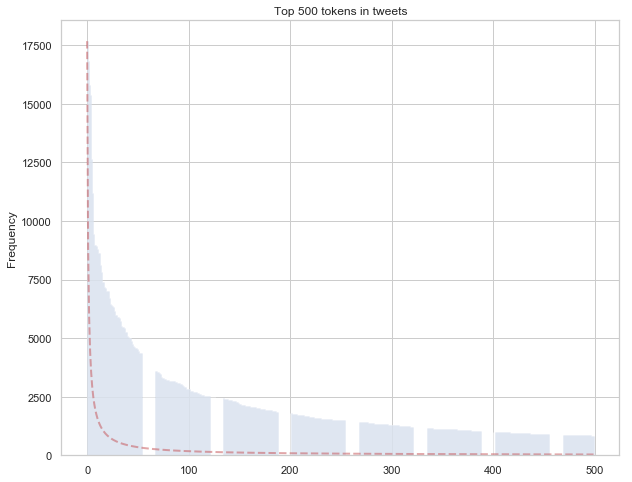

In [116]:
y_pos = np.arange(500)
plt.figure(figsize=(10,8))
s = 1
expected_zipf = [term_freq_df.sort_values(by='total', ascending=False)['total'][0]/(i+1)**s for i in y_pos]
plt.bar(y_pos, term_freq_df.sort_values(by='total', ascending=False)['total'][:500], align='center', alpha=0.5)
plt.plot(y_pos, expected_zipf, color='r', linestyle='--',linewidth=2,alpha=0.5)
plt.ylabel('Frequency')
plt.title('Top 500 tokens in tweets')

On the X-axis is the rank of the frequency from highest rank from left up to 500th rank to the right. Y-axis is the frequency observed in the corpus (in this case, "Sentiment140" dataset). One thing to note is that the actual observations in most cases does not strictly follow Zipf's distribution, but rather follow the trend of "near-Zipfian" distribution.

Even though we can see the plot follows the trend of Zipf's Law, but it looks like it has more area above the expected Zipf curve in higher ranked words.

Another way to plot this is on a log-log graph, with X-axis being log(rank), Y-axis being log(frequency). By plotting on the log-log scale the result will yield roughly linear line on the graph.

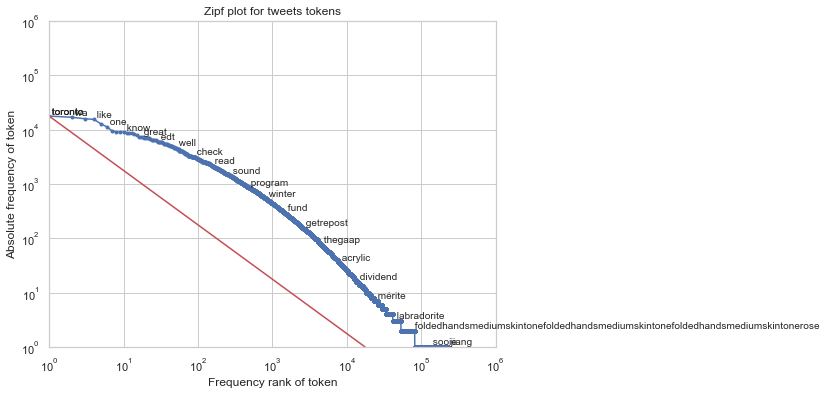

In [124]:
from pylab import *
counts = term_freq_df.total
tokens = term_freq_df.index
ranks = arange(1, len(counts)+1)
indices = argsort(-counts)
frequencies = counts[indices]
plt.figure(figsize=(8,6))
plt.ylim(1,10**6)
plt.xlim(1,10**6)
loglog(ranks, frequencies, marker=".")
plt.plot([1,frequencies[0]],[frequencies[0],1],color='r')
title("Zipf plot for tweets tokens")
xlabel("Frequency rank of token")
ylabel("Absolute frequency of token")
grid(True)
for n in list(logspace(-0.5, log10(len(counts)-2), 25).astype(int)):
    dummy = text(ranks[n], frequencies[n], " " + tokens[indices[n]], 
                 verticalalignment="bottom",
                 horizontalalignment="left")

Text(0.5, 1.0, 'Top 50 tokens in negative tweets')

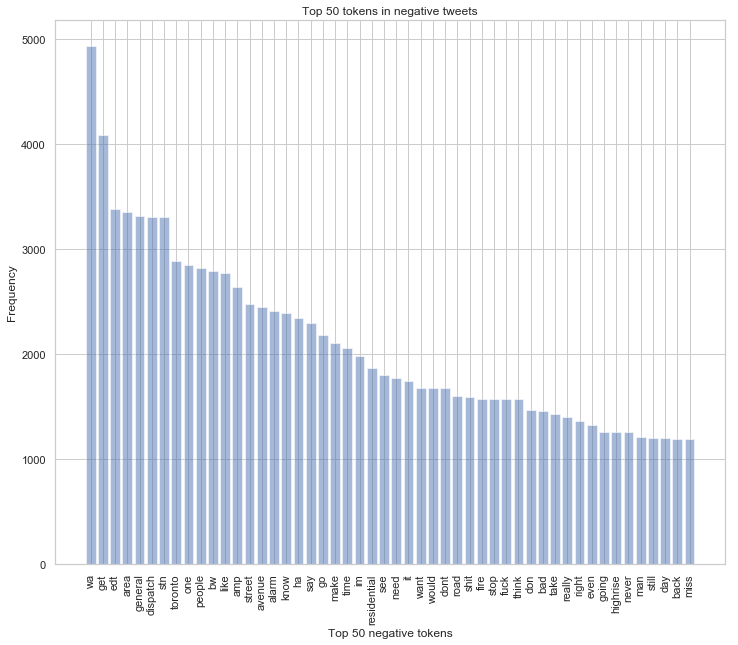

In [126]:
y_pos = np.arange(50)
plt.figure(figsize=(12,10))
plt.bar(y_pos, term_freq_df.sort_values(by='negative', ascending=False)['negative'][:50], align='center', alpha=0.5)
plt.xticks(y_pos, term_freq_df.sort_values(by='negative', ascending=False)['negative'][:50].index,rotation='vertical')
plt.ylabel('Frequency')
plt.xlabel('Top 50 negative tokens')
plt.title('Top 50 tokens in negative tweets')

Text(0.5, 1.0, 'Top 50 tokens in positive tweets')

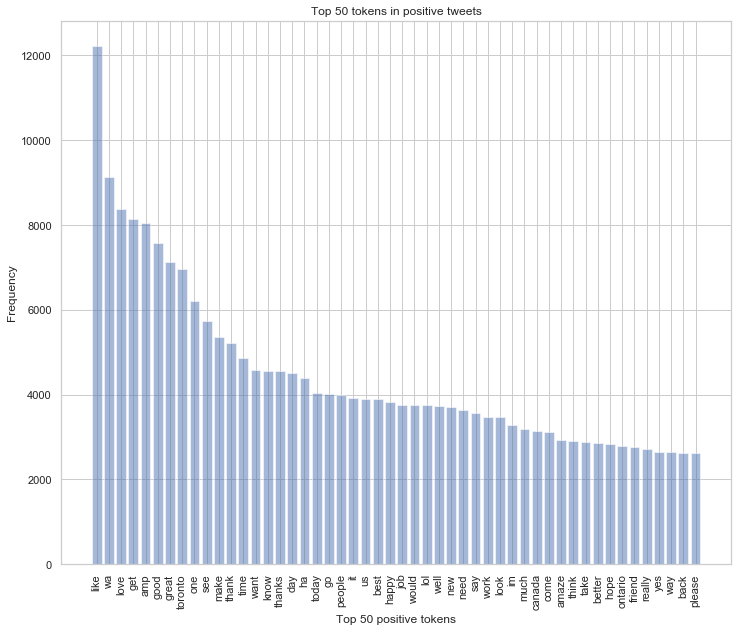

In [127]:
y_pos = np.arange(50)
plt.figure(figsize=(12,10))
plt.bar(y_pos, term_freq_df.sort_values(by='positive', ascending=False)['positive'][:50], align='center', alpha=0.5)
plt.xticks(y_pos, term_freq_df.sort_values(by='positive', ascending=False)['positive'][:50].index,rotation='vertical')
plt.ylabel('Frequency')
plt.xlabel('Top 50 positive tokens')
plt.title('Top 50 tokens in positive tweets')

Text(0.5, 1.0, 'Negative Frequency vs Positive Frequency')

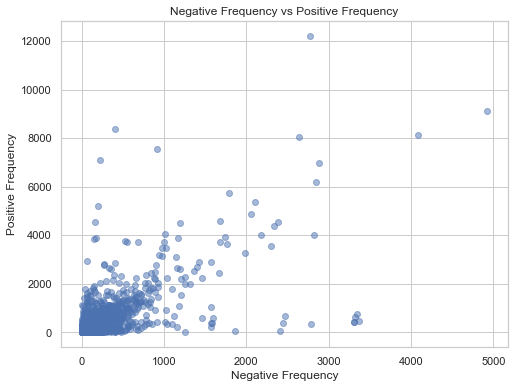

In [128]:
import seaborn as sns
plt.figure(figsize=(8,6))
ax = sns.regplot(x="negative", y="positive",fit_reg=False, scatter_kws={'alpha':0.5},data=term_freq_df)
plt.ylabel('Positive Frequency')
plt.xlabel('Negative Frequency')
plt.title('Negative Frequency vs Positive Frequency')

Most of the words are below 2,000 on both X-axis and Y-axis, and we cannot see a meaningful relation between negative and positive frequency.

In order to come up with a meaningful metric which can characterise important tokens in each class, I borrowed a metric presented by Jason Kessler in PyData 2017 Seattle. In the talk, he presented a Python library called Scattertext. The metrics used in the Scattertext as a way of visualising text data are very useful in filtering meaningful tokens from the frequency data.

Intuitively, if a word appears more often in one class compared to another, this can be a good measure of how much the word is meaningful to characterise the class. In the below code I named it as 'pos_rate', and as you can see from the calculation of the code, this is defined as $${pos\_rate} = \frac{positive\ frequency} {positive\ frequency + negative\ frequency}$$

In [129]:
term_freq_df['pos_rate'] = term_freq_df['positive'] * 1./term_freq_df['total']
term_freq_df.sort_values(by='pos_rate', ascending=False).iloc[:10]

,negative,positive,neutral,total,pos_rate
seasonally,0,1,0,1,1.0
colirio,0,1,0,1,1.0
jennymcminn,0,1,0,1,1.0
jennylatinacurvybrunette,0,1,0,1,1.0
jennny,0,1,0,1,1.0
jennjevons,0,1,0,1,1.0
uselessthis,0,1,0,1,1.0
jennifers,0,1,0,1,1.0
jenniferlopez,0,1,0,1,1.0
jenniferkelly,0,3,0,3,1.0


Words with highest pos_rate have zero frequency in the negative tweets, but overall frequency of these words are too low to think of it as a guideline for positive tweets.

Another metric is the frequency a words occurs in the class. This is defined as $${pos\_freq\_pct} = \frac {positive\ frequency} {\Sigma positive\ frequency}$$

In [130]:
term_freq_df['pos_freq_pct'] = term_freq_df['positive'] * 1./term_freq_df['positive'].sum()
term_freq_df.sort_values(by='pos_freq_pct', ascending=False).iloc[:10]

,negative,positive,neutral,total,pos_rate,pos_freq_pct
like,2768,12210,409,15387,0.793527,0.008965
wa,4929,9130,2784,16843,0.542065,0.006704
love,402,8383,186,8971,0.934455,0.006155
get,4081,8138,3586,15805,0.514900,0.005975
amp,2637,8046,1964,12647,0.636198,0.005908
good,917,7573,144,8634,0.877114,0.005560
great,225,7119,35,7379,0.964765,0.005227
toronto,2883,6964,7828,17675,0.394003,0.005113
one,2841,6208,2138,11187,0.554930,0.004558
see,1795,5744,1906,9445,0.608152,0.004217


But since pos_freq_pct is just the frequency scaled over the total sum of the frequency, the rank of pos_freq_pct is exactly same as just the positive frequency.

What we can do now is to combine pos_rate, pos_freq_pct together to come up with a metric which reflects both pos_rate and pos_freq_pct. Even though both of these can take a value ranging from 0 to 1, pos_rate has much wider range actually spanning from 0 to 1, while all the pos_freq_pct values are squashed within the range smaller than 0.015. If we average these two numbers, pos_rate will be too dominant, and will not reflect both metrics effectively.

So here we use harmonic mean instead of arithmetic mean. "Since the harmonic mean of a list of numbers tends strongly toward the least elements of the list, it tends (compared to the arithmetic mean) to mitigate the impact of large outliers and aggravate the impact of small ones." The harmonic mean H of the positive real number x1,x2,...xn is defined as $${H} = \frac {n}{\sum_{i=1}^{n}\ \frac{1}{x_i}}$$

In [131]:
from scipy.stats import hmean

term_freq_df['pos_hmean'] = term_freq_df.apply(lambda x: (hmean([x['pos_rate'], x['pos_freq_pct']])
                                                                   if x['pos_rate'] > 0 and x['pos_freq_pct'] > 0 
                                                                   else 0), axis=1)                                                        
term_freq_df.sort_values(by='pos_hmean', ascending=False).iloc[:10]

,negative,positive,neutral,total,pos_rate,pos_freq_pct,pos_hmean
like,2768,12210,409,15387,0.793527,0.008965,0.017730
wa,4929,9130,2784,16843,0.542065,0.006704,0.013243
love,402,8383,186,8971,0.934455,0.006155,0.012230
get,4081,8138,3586,15805,0.514900,0.005975,0.011813
amp,2637,8046,1964,12647,0.636198,0.005908,0.011707
good,917,7573,144,8634,0.877114,0.005560,0.011051
great,225,7119,35,7379,0.964765,0.005227,0.010398
toronto,2883,6964,7828,17675,0.394003,0.005113,0.010095
one,2841,6208,2138,11187,0.554930,0.004558,0.009042
see,1795,5744,1906,9445,0.608152,0.004217,0.008377


The harmonic mean rank seems like the same as pos_freq_pct. By calculating the harmonic mean, the impact of small value (in this case, pos_freq_pct) is too aggravated and ended up dominating the mean value. This is again exactly same as just the frequency value rank and doesn't provide a meaningful result.

What we can try next is to get the CDF (Cumulative Distribution Function) value of both pos_rate and pos_freq_pct. CDF can be explained as "distribution function of X, evaluated at x, is the probability that X will take a value less than or equal to x". By calculating CDF value, we can see where the value of either pos_rate or pos_freq_pct lies in the distribution in terms of cumulative manner. In the below result of the code, we can see a word "welcome" with pos_rate_normcdf of 0.995625, and pos_freq_pct_normcdf of 0.999354. This means roughly 99.56% of the tokens will take a pos_rate value less than or equal to 0.91535, and 99.99% will take a pos_freq_pct value less than or equal to 0.001521.

Next, we calculate a harmonic mean of these two CDF values, as we did earlier. By calculating the harmonic mean, we can see that pos_normcdf_hmean metric provides a more meaningful measure of how important a word is within the class.

In [133]:
from scipy.stats import norm
def normcdf(x):
    return norm.cdf(x, x.mean(), x.std())

term_freq_df['pos_rate_normcdf'] = normcdf(term_freq_df['pos_rate'])
term_freq_df['pos_freq_pct_normcdf'] = normcdf(term_freq_df['pos_freq_pct'])
term_freq_df['pos_normcdf_hmean'] = hmean([term_freq_df['pos_rate_normcdf'], term_freq_df['pos_freq_pct_normcdf']])
term_freq_df.sort_values(by='pos_normcdf_hmean', ascending=False).iloc[:10]

,negative,positive,neutral,total,pos_rate,pos_freq_pct,pos_hmean,pos_rate_normcdf,pos_freq_pct_normcdf,pos_normcdf_hmean
hahaha,11,866,6,883,0.980747,0.000636,0.001271,0.926188,1.000000,0.961680
informational,1,227,0,228,0.995614,0.000167,0.000333,0.930885,0.994377,0.961584
congratulations,6,1146,19,1171,0.978651,0.000841,0.001681,0.925506,1.000000,0.961312
lovely,8,467,4,479,0.974948,0.000343,0.000686,0.924290,1.000000,0.960656
wonderful,17,772,4,793,0.973518,0.000567,0.001133,0.923817,1.000000,0.960400
congrats,19,1092,11,1122,0.973262,0.000802,0.001602,0.923732,1.000000,0.960354
fantastic,10,559,6,575,0.972174,0.000410,0.000821,0.923370,1.000000,0.960158
award,11,648,10,669,0.968610,0.000476,0.000951,0.922175,1.000000,0.959512
amaze,63,2928,35,3026,0.967614,0.002150,0.004290,0.921838,1.000000,0.959330
great,225,7119,35,7379,0.964765,0.005227,0.010398,0.920870,1.000000,0.958805


In [134]:
# Apply the same calculation to negative frequency of each word.
term_freq_df['neg_rate'] = term_freq_df['negative'] * 1./term_freq_df['total']
term_freq_df['neg_freq_pct'] = term_freq_df['negative'] * 1./term_freq_df['negative'].sum()
term_freq_df['neg_hmean'] = term_freq_df.apply(lambda x: (hmean([x['neg_rate'], x['neg_freq_pct']])
                                                                   if x['neg_rate'] > 0 and x['neg_freq_pct'] > 0 
                                                                   else 0), axis=1)                                                        
term_freq_df['neg_rate_normcdf'] = normcdf(term_freq_df['neg_rate'])
term_freq_df['neg_freq_pct_normcdf'] = normcdf(term_freq_df['neg_freq_pct'])
term_freq_df['neg_normcdf_hmean'] = hmean([term_freq_df['neg_rate_normcdf'], term_freq_df['neg_freq_pct_normcdf']])
term_freq_df.sort_values(by='neg_normcdf_hmean', ascending=False).iloc[:10]

,negative,positive,neutral,total,pos_rate,pos_freq_pct,pos_hmean,pos_rate_normcdf,pos_freq_pct_normcdf,pos_normcdf_hmean,neg_rate,neg_freq_pct,neg_hmean,neg_rate_normcdf,neg_freq_pct_normcdf,neg_normcdf_hmean
highrise,1256,21,2,1279,0.016419,0.000015,0.000031,0.215883,0.568734,0.312968,0.982017,0.001878,0.003748,0.994162,1.000000,0.997073
grassrubbish,244,6,0,250,0.024000,0.000004,0.000009,0.221063,0.500469,0.306667,0.976000,0.000365,0.000729,0.993848,1.000000,0.996914
commercialindustrial,409,10,2,421,0.023753,0.000007,0.000015,0.220893,0.518758,0.309849,0.971496,0.000611,0.001222,0.993603,1.000000,0.996791
alarm,2412,76,2,2490,0.030522,0.000056,0.000111,0.225575,0.789225,0.350866,0.968675,0.003606,0.007185,0.993445,1.000000,0.996712
residential,1862,60,9,1931,0.031072,0.000044,0.000088,0.225958,0.732467,0.345372,0.964267,0.002784,0.005552,0.993192,1.000000,0.996584
distchief11,222,0,12,234,0.000000,0.000000,0.000000,0.204909,0.473046,0.285953,0.948718,0.000332,0.000664,0.992227,1.000000,0.996098
highrise332,404,6,18,428,0.014019,0.000004,0.000009,0.214258,0.500469,0.300057,0.943925,0.000604,0.001207,0.991906,1.000000,0.995937
tower333,161,2,8,171,0.011696,0.000001,0.000003,0.212692,0.482179,0.295179,0.941520,0.000241,0.000481,0.991741,0.999951,0.995829
distchief32,190,0,12,202,0.000000,0.000000,0.000000,0.204909,0.473046,0.285953,0.940594,0.000284,0.000568,0.991676,0.999998,0.995820
aerial315,185,8,4,197,0.040609,0.000006,0.000012,0.232656,0.509616,0.319465,0.939086,0.000277,0.000553,0.991571,0.999996,0.995766


Text(0.5, 1.0, 'neg_hmean vs pos_hmean')

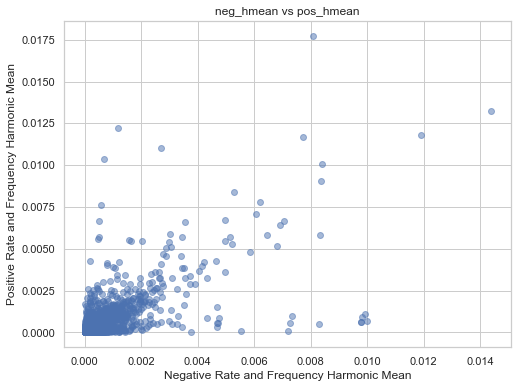

In [135]:
plt.figure(figsize=(8,6))
ax = sns.regplot(x="neg_hmean", y="pos_hmean",fit_reg=False, scatter_kws={'alpha':0.5},data=term_freq_df)
plt.ylabel('Positive Rate and Frequency Harmonic Mean')
plt.xlabel('Negative Rate and Frequency Harmonic Mean')
plt.title('neg_hmean vs pos_hmean')

Text(0.5, 1.0, 'neg_normcdf_hmean vs pos_normcdf_hmean')

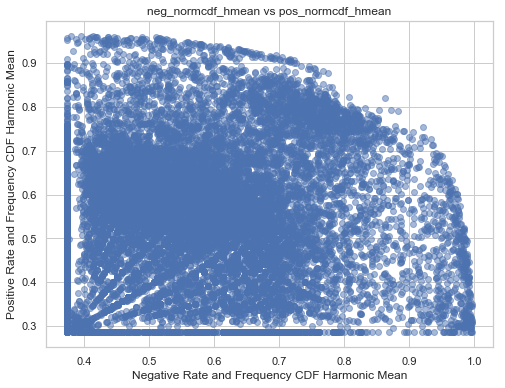

In [136]:
plt.figure(figsize=(8,6))
ax = sns.regplot(x="neg_normcdf_hmean", y="pos_normcdf_hmean",fit_reg=False, scatter_kws={'alpha':0.5},data=term_freq_df)
plt.ylabel('Positive Rate and Frequency CDF Harmonic Mean')
plt.xlabel('Negative Rate and Frequency CDF Harmonic Mean')
plt.title('neg_normcdf_hmean vs pos_normcdf_hmean')

It seems like the harmonic mean of rate CDF and frequency CDF has created an interesting pattern on the plot. If a data point is near to upper left corner, it is more positive, and if it is closer to the bottom right corner, it is more negative.

It is good that the metric has created some meaningful insight out of frequency, but with text data, showing every token as just a dot is lacking important information on which token each data point represents. With 10,000 points, it is difficult to annotate all of the points on the plot. For this part, I have tried several methods and came to a conclusion that it is not very practical or feasible to directly annotate data points on the plot.

So I took an alternative method of the interactive plot with Bokeh. Bokeh is an interactive visualisation library for Python, which creates graphics in style of D3.js. Bokeh can output the result in HTML format or also within the Jupyter Notebook. And below is the plot created with Bokeh.

In [137]:
from bokeh.plotting import figure
from bokeh.io import output_notebook, show
from bokeh.models import LinearColorMapper
output_notebook()
color_mapper = LinearColorMapper(palette='Inferno256', low=min(term_freq_df.pos_normcdf_hmean), high=max(term_freq_df.pos_normcdf_hmean))
p = figure(x_axis_label='neg_normcdf_hmean', y_axis_label='pos_normcdf_hmean')
p.circle('neg_normcdf_hmean','pos_normcdf_hmean',size=5,alpha=0.3,source=term_freq_df,color={'field': 'pos_normcdf_hmean', 'transform': color_mapper})
from bokeh.models import HoverTool
hover = HoverTool(tooltips=[('token','@index')])
p.add_tools(hover)
show(p)

Loading BokehJS ...

In [ ]:
# after running all of this, found numerical values really impacted the graph
# remove numbers
# remove user names 
# remove hashtags

# After removing everything... rerun and see if the graphs produce better results